In [ ]:
"""
Created on 05/12/2023

Author: dmitrychezganov

Script is statistical treatment of domain size


"""

In [69]:
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
from scipy.stats import norm
import math
import statistics
import numpy as np
import scipy.stats
import pandas as pd
# import seaborn as sns

This cell contains the imports of necessary libraries and modules used throughout the notebook. It includes libraries for numerical operations, data manipulation, statistical analysis, and plotting. Additionally, it imports modules for handling file operations and creating directories.

In [70]:
# make a folder
def make_folder(path_to_folder_to_read, folder_name):
    if not os.path.exists(os.path.join((path_to_folder_to_read + folder_name))):
        try:
            os.makedirs(os.path.join(path_to_folder_to_read + folder_name))
        except OSError: print(f'Creation of the directory {os.path.join(path_to_folder_to_read + folder_name)} failed. Probably already present.\n')
        else:
            print(f'Successfully created the directory {os.path.join(path_to_folder_to_read + folder_name)}\n')
    path_to_save = path_to_folder_to_read +folder_name+'/'
    return path_to_save

def adjust_data_range(image: np.ndarray,
                        p_low: float=0.5,
                        p_high: float=99.8) -> np.ndarray:
    """Clip image values between the p_low and p_high percentile values
    Args:
        image: 2D numpy array
        p_low: lower percentile value (default: 5)
        p_high: higher percentile value (default: 95)
    Return:
        clipped image
    """
    if image is None:
        raise ValueError("Image is None")
    if image.ndim != 2:
        raise ValueError("Image must be 2D")
    low, top = np.percentile(image, (p_low, p_high))
    image = np.clip(image, low, top) # clip the image between low and top
    return image

This cell contains the definitions of two functions: `make_folder` and `adjust_data_range`. The `make_folder` function creates a new directory if it does not already exist, and returns the path to the newly created directory. The `adjust_data_range` function clips the values of a 2D numpy array (image) between specified lower and upper percentiles.

In [71]:
print(f'######################\n')
print(f'Current working directory: {os.getcwd()}\n')
# path with folders that contains the domain size data as txt files
path_to_read = '/Volumes/industry/industry08/Reports/2023-13_HNS_for_diff_T/domain_sizes/'

print(f'-----------------------\n')
# folder to save plots
print(f'Folder to save plots: {path_to_read}\n')
path_to_save_big_plots = make_folder(path_to_read, 'plots')
print(f'######################\n')

# folder to save csv files
print(f'Folder to save csv files: {path_to_read}\n')
path_to_save_csv = make_folder(path_to_read, 'csv_data')
print(f'######################\n')

######################

Current working directory: /Users/dmitrychezganov/Library/CloudStorage/SynologyDrive-Macbook1/Coding/Github_portfolio/Odered_disordered_domains

-----------------------

Folder to save plots: /Volumes/industry/industry08/Reports/2023-13_HNS_for_diff_T/domain_sizes/

######################

Folder to save csv files: /Volumes/industry/industry08/Reports/2023-13_HNS_for_diff_T/domain_sizes/

######################



This cell contains the definitions of various variables used throughout the notebook. These variables include dataframes, dictionaries, and other data structures that store information related to domain sizes, statistical analysis, and plotting. The variables are used in subsequent cells for data manipulation, statistical calculations, and visualization.

In [72]:

print(f'Folders in the working directory:\n')
# get all folders in the path
folders = glob.glob(path_to_read + '*/')
for i, folder in enumerate(folders):
    # take the name of the last folder in the path
    folder = folder.split('/')[-2]
    print(f'{i+1}. {folder}')
# exclude the folder path that ends with 'plots'
folders = [folder for folder in folders if folder.split('/')[-2] != 'plots']
print(f'-----------------------\n')
# exclude the folder path that ends with 'plots'
folders = [folder for folder in folders if folder.split('/')[-2] != 'csv_data']
print(f'-----------------------\n')
# exclude the folder path that ends with 'plots'
folders = [folder for folder in folders if folder.split('/')[-2] != 'plots_old']
print(f'-----------------------\n')

# make a dictionary from the names of subfolders for each folder
folders_dict = {}
for folder in folders:
    # take the name of the last folder in the path
    folder_name = folder.split('/')[-2]
    # make a list of subfolders
    subfolders = glob.glob(folder + '*/')
    # make a dictionary from the names of subfolders for each folder
    folders_dict[folder_name] = subfolders

# print folders and subfolders
print(f'-----------------------\n')
print(f'Folders and subfolders with data in the working directory:\n')
for i, folder in enumerate(folders_dict.keys()):
    print(f'{i+1}. {folder}')
    for j, subfolder in enumerate(folders_dict[folder]):
        subfolder = subfolder.split('/')[-2]
        print(f'\t{j+1}. {subfolder}')
print(f'-----------------------\n')

# sort the folders_dict keys
folders_dict = dict(sorted(folders_dict.items()))

Folders in the working directory:

1. HNS_650C_2023-13
2. HNS_0C_sieved40um_2023-13
3. plots_old
4. HNS_625C_2023-13
5. HNS_675C_2023-09
6. HNS_700C_2023-13
7. plots
8. csv_data
-----------------------

-----------------------

-----------------------

-----------------------

Folders and subfolders with data in the working directory:

1. HNS_650C_2023-13
	1. 5 um
	2. 1 um
	3. 3 um
	4. plots
	5. 0_7 um
	6. 0 um
2. HNS_0C_sieved40um_2023-13
	1. 5 um
	2. 1 um
	3. 3 um
	4. 0_5 um
	5. 0 um
3. HNS_625C_2023-13
	1. 5 um
	2. 1 um
	3. 3 um
	4. 0_5 um
	5. 0 um
4. HNS_675C_2023-09
	1. some distance
	2. plots
5. HNS_700C_2023-13
	1. 5 um
	2. 1 um
	3. 3 um
	4. plots
	5. 0_5 um
	6. 0 um
-----------------------



In [73]:
# make a dictionary for each folder
# data_dict = {}
# for folder in folders_dict.keys():
#     data_dict[folder] = {}
#     for subfolder in folders_dict[folder]:
#         subfolder_name = subfolder.split('/')[-2]
#         data_dict[folder][subfolder_name] = {}
#         # get all txt files in the subfolder
#         txt_files = glob.glob(subfolder + '*.txt')
#         # make a dictionary from the names of txt files for each subfolder
#         data_dict[folder][subfolder_name]['txt_files'] = txt_files
#         # make a dictionary from the names of txt files for each subfolder
#         data_dict[folder][subfolder_name]['data'] = {}
#         for txt_file in txt_files:
#             # take the name of the last txt file in the path
#             txt_file_name = txt_file.split('/')[-1]
#             # read txt file
#             data = np.loadtxt(txt_file, delimiter=',')
# #             # make a dictionary from the names of txt files for each subfolder
#             data_dict[folder][subfolder_name]['data'][txt_file_name] = data

This cell contains the commented-out code for creating a dictionary for each folder. The code iterates through the folders and subfolders, reads the text files, and stores the data in a nested dictionary structure. The dictionary keys are the folder and subfolder names, and the values are dictionaries containing the text file names and their corresponding data.

In [74]:
# pixel size
px_size_640 = 0.06582 # nm for 640kx
px_size_910 = 0.0465 # nm for 910kx
px_size_1_3M = 0.0329 # nm for 1.3Mx
# create a dict of dataframes
df_dict_folder = {}
for folder in folders_dict.keys():
    if folder == 'HNS_625C_2023-13':
        px_size = px_size_910
    elif folder == 'HNS_0C_sieved40um_2023-13':
        px_size = px_size_1_3M
    else:
        px_size = px_size_640

    print(f'Folder: {folder} and pixel size: {px_size}\n')
    subfolders_sample_temperature = folders_dict[folder]

    # loop over subfolders to checkk if there are files inside
    for subfolder in subfolders_sample_temperature: # in each subfolder we have folders with different depths
        files = glob.glob(subfolder + '*.txt')
        # check if the list of files is not empty
        if not files:
            # exlude the subfolder from the list of subfolders
            subfolders_sample_temperature.remove(subfolder)

    # sort subfolders
    subfolders_sample_temperature.sort()
    # col_names = []
    # for subfolder in subfolders_sample_temperature:
    #     col_names.append(subfolder.split('/')[-2])

    # #make list of row names
    # col_names = list(col_names)*2
    # # add '_A' to first half of row names and '_d' to the second half
    # col_names[:int(len(col_names)/2)] = [col_name + '_A' for col_name in col_names[:int(len(col_names)/2)]]
    # col_names[int(len(col_names)/2):] = [col_name + '_d' for col_name in col_names[int(len(col_names)/2):]]
    # # make a list of row names
    # # row_names = ['0 um', '0.5 um', '1 um', '3 um', '5 um']
    # df_dict[folder] = pd.DataFrame(columns=col_names)
    df_dict_subfolder = {}
    for idx, subfolder in enumerate(subfolders_sample_temperature):
        # subfolder name
        subfolder_name = subfolder.split('/')[-2]
        # get all txt files in the subfolder
        txt_files = glob.glob(subfolder + '*.txt')
        # sort txt_files
        txt_files.sort()
        df_dict_subfolder[subfolder] = pd.DataFrame()
        # loop over txt files
        for txt_file in txt_files:
            # take the name of the last txt file in the path
            txt_file_name = txt_file.split('/')[-1]
            # read txt file
            data = np.loadtxt(txt_file, delimiter=',')
            
            if txt_file_name == 'areas.txt':
                df_dict_subfolder[subfolder][subfolder_name+'_A'] = data*px_size**2
            else:
                df_dict_subfolder[subfolder][subfolder_name+'_d'] = data*px_size
    # merge dataframes
    df_dict_folder[folder] = pd.concat(df_dict_subfolder.values(), axis=1)

Folder: HNS_0C_sieved40um_2023-13 and pixel size: 0.0329

Folder: HNS_625C_2023-13 and pixel size: 0.0465

Folder: HNS_650C_2023-13 and pixel size: 0.06582

Folder: HNS_675C_2023-09 and pixel size: 0.06582

Folder: HNS_700C_2023-13 and pixel size: 0.06582



This cell contains the code for creating a dictionary for each folder. The code iterates through the folders and subfolders, reads the text files, and stores the data in a nested dictionary structure. The dictionary keys are the folder and subfolder names, and the values are dictionaries containing the text file names and their corresponding data.

In [75]:
# save dataframes
for folder in df_dict_folder.keys():
    df_dict_folder[folder].to_csv(path_to_save_csv + folder + '.csv', index=False)

print(f'-----------------------\n')
print(f'Dataframes saved in {path_to_save_csv}\n')
print(f'-----------------------\n')

-----------------------

Dataframes saved in /Volumes/industry/industry08/Reports/2023-13_HNS_for_diff_T/domain_sizes/csv_data/

-----------------------



This cell contains the code for saving the dataframes created in the previous cells to CSV files. The dataframes are saved in the specified directory with appropriate filenames. The cell also prints a message indicating the location where the dataframes have been saved.

In [76]:
# create dict for statistics
df_statistics_dict = {}
# loop over folders
for folder in df_dict_folder.keys():
    df_statistics_dict[folder] = df_dict_folder[folder].describe()
    df_statistics_dict[folder].loc['skewness'] = df_dict_folder[folder].skew()
    df_statistics_dict[folder].loc['kurtosis'] = df_dict_folder[folder].kurtosis()
    df_statistics_dict[folder].loc['median'] = df_dict_folder[folder].median()
    # mode
    df_statistics_dict[folder].loc['mode'] = df_dict_folder[folder].mode().iloc[0]
    # variance
    df_statistics_dict[folder].loc['variance'] = df_dict_folder[folder].var()

This cell contains the code for creating a dictionary for each folder. The code iterates through the folders and subfolders, reads the text files, and stores the data in a nested dictionary structure. The dictionary keys are the folder and subfolder names, and the values are dictionaries containing the text file names and their corresponding data.

In [77]:
# save statistics
for folder in df_statistics_dict.keys():
    df_statistics_dict[folder].to_csv(path_to_save_csv + folder + '_statistics.csv', index=True)

This cell contains the code for creating a Word document that includes descriptive statistics for domain sizes in each folder. The document is formatted with appropriate headings, text, and tables. Each table contains statistical measures such as count, mean, standard deviation, minimum, 25th percentile, median, 75th percentile, maximum, skewness, kurtosis, mode, and variance for both area and equivalent diameter of domains. The document is saved in the specified directory and opened automatically.

In [91]:
from docx import Document
from docx.shared import Inches
from docx.enum.table import WD_TABLE_ALIGNMENT
from docx.enum.text import WD_ALIGN_PARAGRAPH
from docx.shared import Pt

# create a document
document = Document()
# set font size
style = document.styles['Normal']
font = style.font
font.name = 'Times New Roman'
font.size = Pt(12)
# change page orientation
sections = document.sections
for section in sections:
    section.orientation = 1 # 0 - portrait, 1 - landscape
    section.page_width = Inches(11.69)
    section.page_height = Inches(8.27)
# add title
document.add_heading('Domain size statistics', 0)
# add text
p = document.add_paragraph('The following tables contain descriptive statistics for domain size in each folder:\n')
p.add_run('Area').bold = True
p.add_run(' is the area of the domain in ')
p.add_run('nm^2\n').bold = True
p.add_run('Diameter').bold = True
p.add_run(' is the equivalent diameter of the domain in ')
p.add_run('nm\n').bold = True
p.add_run('Count').bold = True
p.add_run(' is the number of domains in the distribution\n')
p.add_run('Mean').bold = True
p.add_run(' is the mean of the distribution\n')
p.add_run('Std').bold = True
p.add_run(' is the standard deviation of the distribution\n')
p.add_run('Min').bold = True
p.add_run(' is the minimum value of the distribution\n')
p.add_run('25%').bold = True
p.add_run(' is the 25th percentile of the distribution\n')
p.add_run('50%').bold = True
p.add_run(' is the 50th percentile of the distribution\n')
p.add_run('75%').bold = True
p.add_run(' is the 75th percentile of the distribution\n')
p.add_run('Max').bold = True
p.add_run(' is the maximum value of the distribution\n')

p.add_run('Skewness').bold = True
p.add_run(' is the degree of distortion from the normal distribution\n')
p.add_run('Kurtosis').bold = True
p.add_run(' is the degree of peakedness of the distribution\n')
p.add_run('Median').bold = True
p.add_run(' is the median of the distribution\n')
p.add_run('Mode').bold = True
p.add_run(' is the mode of the distribution\n')
p.add_run('Variance').bold = True
p.add_run(' is the variance of the distribution')
document.add_page_break()

# loop over folders
for idx, folder in enumerate(df_statistics_dict.keys()):
    # add table caption
    table_caption = document.add_paragraph()
    table_caption.alignment = WD_ALIGN_PARAGRAPH.CENTER
    table_caption.add_run(f'Table {idx+1}. Descriptive statistics for domain size in {folder}').bold = True
    # create a table
    table = document.add_table(rows=df_statistics_dict[folder].shape[0]+1, cols=df_statistics_dict[folder].shape[1]+1)
    table.style = 'Table Grid'
    # fill the first row with column names
    for j in range(df_statistics_dict[folder].shape[1]):
        table.cell(0, j+1).text = df_statistics_dict[folder].columns[j]
        #make the first row bold
        table.cell(0, j+1).paragraphs[0].runs[0].font.bold = True
    # fill the first column with row names
    for i in range(df_statistics_dict[folder].shape[0]):
        table.cell(i+1, 0).text = df_statistics_dict[folder].index[i]
        #make the first column bold
        table.cell(i+1, 0).paragraphs[0].runs[0].font.bold = True

    # fill the table with data
    for i in range(df_statistics_dict[folder].shape[0]):
        for j in range(df_statistics_dict[folder].shape[1]):
            # table.cell(i, j).text = str(df_statistics_dict[folder].iloc[i, j])
            table.cell(i+1, j+1).text = "{:.2f}".format(df_statistics_dict[folder].iloc[i, j])
    # set table alignment
    table.alignment = WD_TABLE_ALIGNMENT.CENTER
    # set table font size
    for row in table.rows:
        for cell in row.cells:
            paragraphs = cell.paragraphs
            for paragraph in paragraphs:
                for run in paragraph.runs:
                    font = run.font
                    font.size = Pt(12)
    
    # add new page
    document.add_page_break()
# save document
document.save(path_to_save_csv + 'statistics.docx')

#open document
os.system(f'open {path_to_save_csv}statistics.docx')

0

This cell contains the code for creating a Word document that includes descriptive statistics for domain sizes in each folder. The document is formatted with appropriate headings, text, and tables. Each table contains statistical measures such as count, mean, standard deviation, minimum, 25th percentile, median, 75th percentile, maximum, skewness, kurtosis, mode, and variance for both area and equivalent diameter of domains. The document is saved in the specified directory and opened automatically.

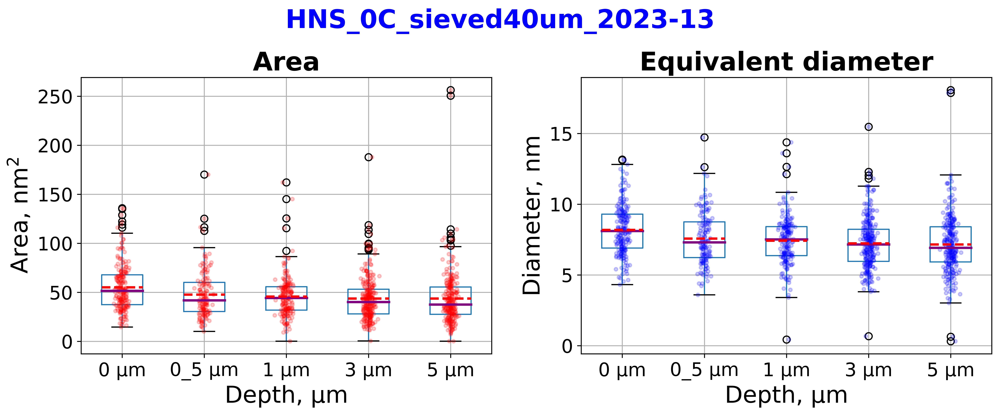

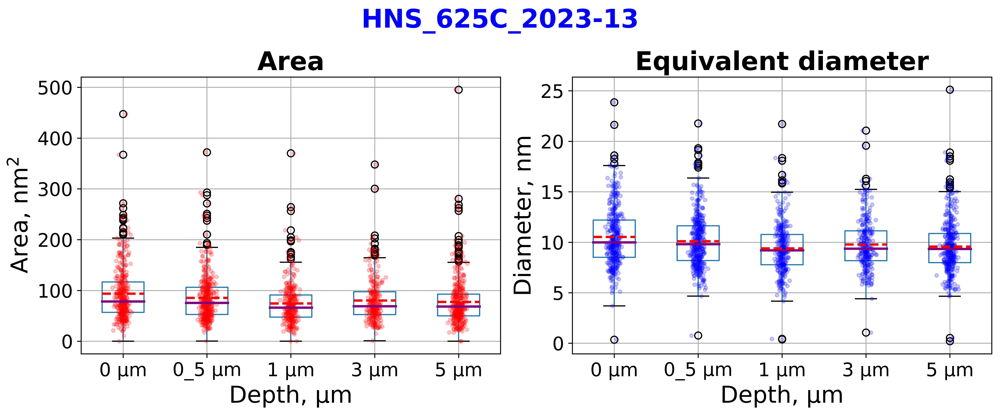

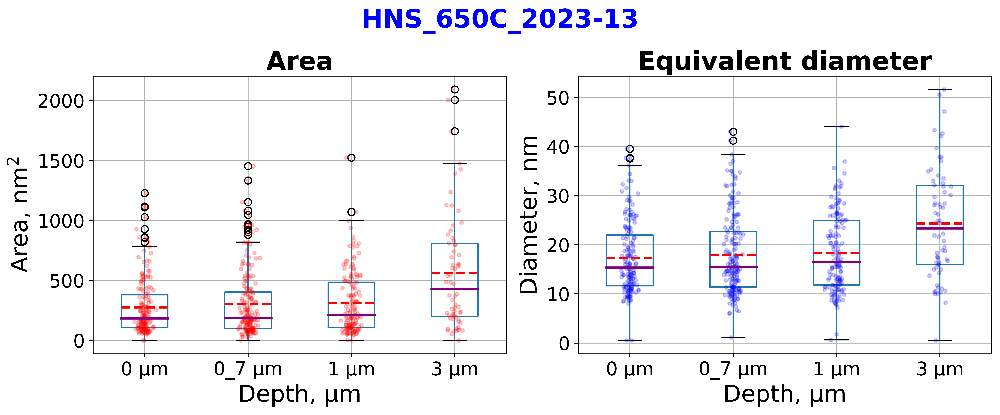

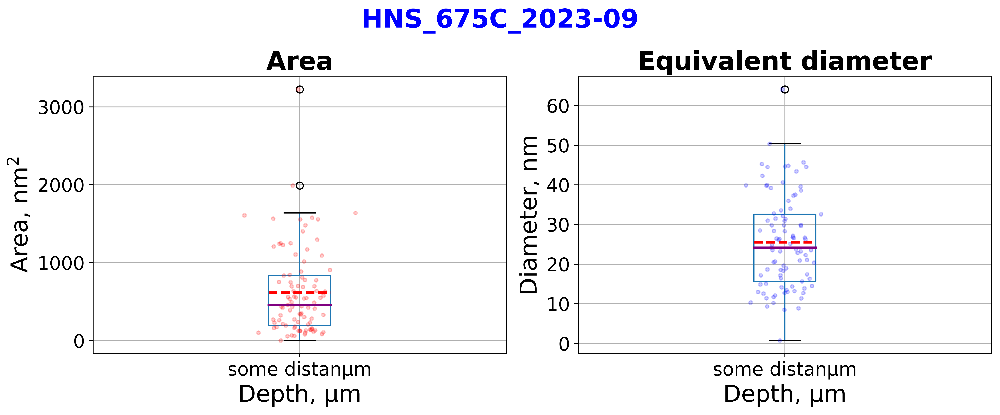

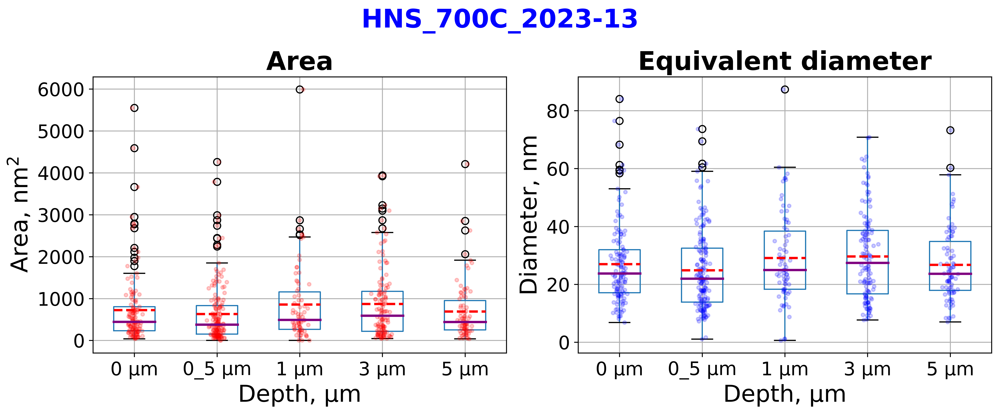

In [79]:
for k, folder in enumerate(df_dict_folder.keys()):
    # boxplot
    fig, ax = plt.subplots(1, 2, figsize=(12, 5), dpi=600)
    # make fig title
    fig.suptitle(folder, fontsize=22, fontweight='bold', color='Blue')
    # Make box plot for Area columns
    df_dict_folder[folder].iloc[:, ::2].boxplot(ax=ax[0],
                                                showmeans=True,
                                                meanline=True,
                                                meanprops={'color': 'red', 'linewidth': 2},
                                                medianprops={'color': 'purple','linewidth': 2},
                                                )

    ax[0].set_title('Area', fontsize=22, fontweight='bold')
    ax[0].set_ylabel('Area, $\\mathrm{nm}^2$', fontsize=20)
    ax[0].set_xlabel('Depth, µm', fontsize=20)
    ax[0].tick_params(axis='both', which='major', labelsize=16)
    # change xticklabels
    xticklabels = [item.get_text() for item in ax[0].get_xticklabels()]
    # xticklabels = [xticklabel[:-2] for xticklabel in xticklabels]
    xticklabels = [xticklabel[:-4]+'µm' for xticklabel in xticklabels]
    ax[0].set_xticklabels(xticklabels)
    # add overlayt with actual data
    for i in range(len(list(df_dict_folder[folder].iloc[:, ::2].columns))):
        y = df_dict_folder[folder].iloc[:, ::2].iloc[:, i]
        x = np.random.normal(i+1, 0.04, size=len(y))
        ax[0].plot(x, y, 'r.', alpha=0.2)


    # Make box plot for Diameter columns
    df_dict_folder[folder].iloc[:, 1::2].boxplot(ax=ax[1],
                                                showmeans=True,
                                                meanline=True,
                                                meanprops={'color': 'red', 'linewidth': 2},
                                                medianprops={'color': 'purple','linewidth': 2},
                                                )
    ax[1].set_title('Equivalent diameter', fontsize=22, fontweight='bold')
    ax[1].set_ylabel('Diameter, nm', fontsize=20)
    ax[1].set_xlabel('Depth, µm', fontsize=20)
    ax[1].tick_params(axis='both', which='major', labelsize=16)
    # change xticklabels
    xticklabels = [item.get_text() for item in ax[1].get_xticklabels()]
    xticklabels = [xticklabel[:-4]+'µm' for xticklabel in xticklabels]
    ax[1].set_xticklabels(xticklabels)
    # add overlayt with actual data
    for i in range(len(list(df_dict_folder[folder].iloc[:, 1::2].columns))):
        y = df_dict_folder[folder].iloc[:, 1::2].iloc[:, i]
        x = np.random.normal(i+1, 0.04, size=len(y))
        ax[1].plot(x, y, 'b.', alpha=0.2)
    fig.tight_layout()

    plt.savefig(path_to_save_big_plots + folder + '_boxplots.png', dpi=300)
    plt.show()

This cell contains the code for generating bar plots for the mean area and equivalent diameter of domains at different temperatures. The bar plots include error bars representing the standard deviation. The x-axis labels are adjusted to show the temperature values. The plots are saved as PNG files in the specified directory.

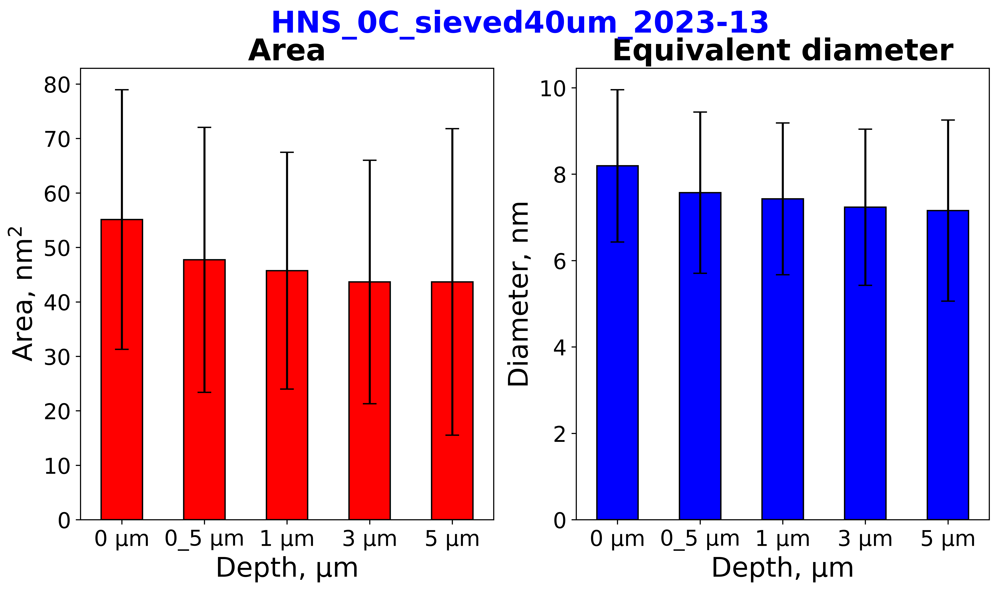

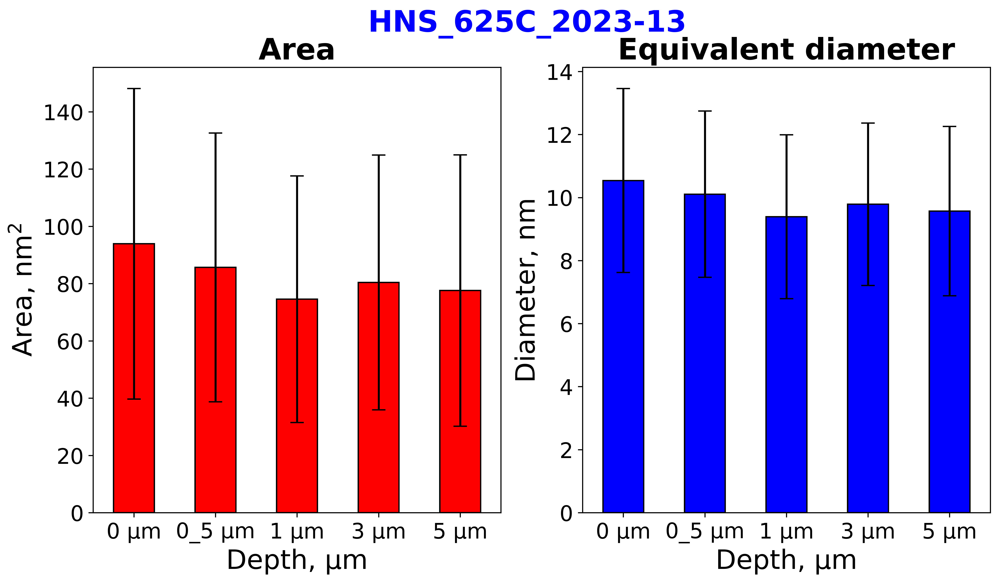

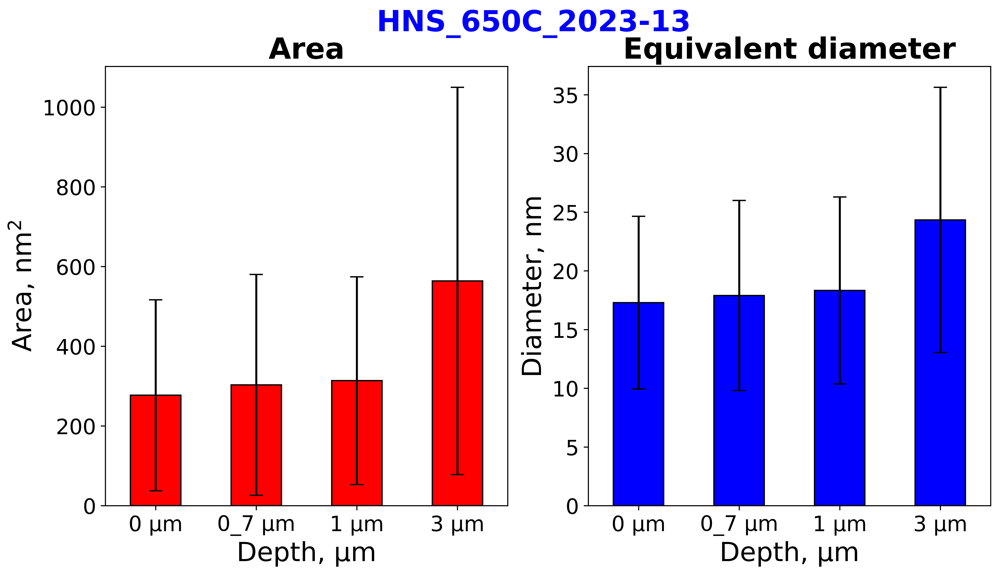

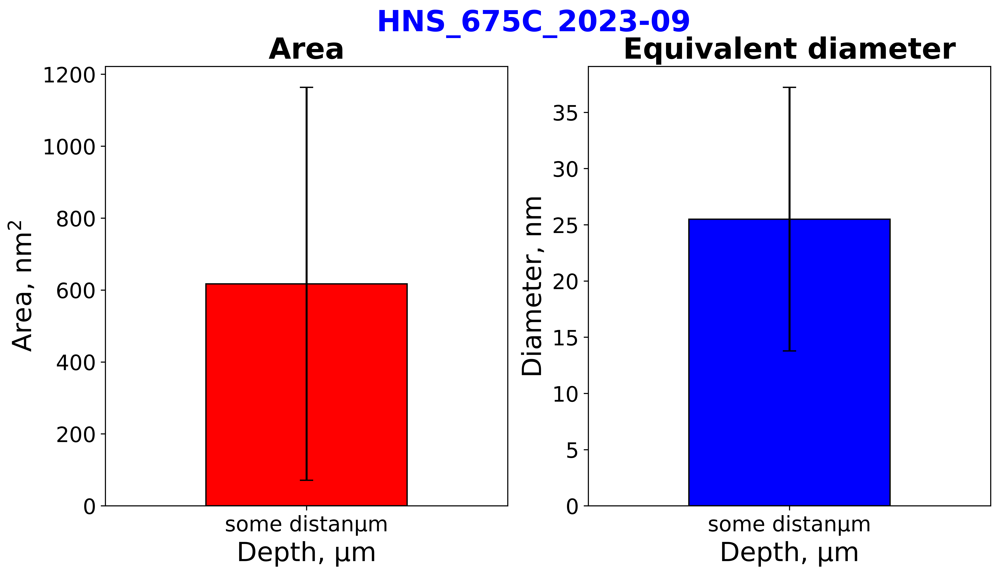

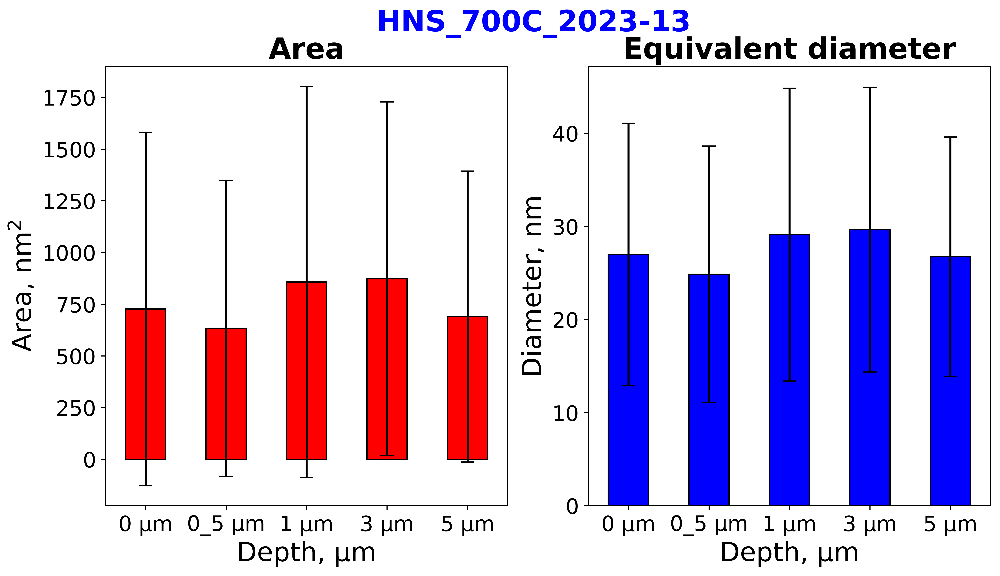

In [80]:
for k, folder in enumerate(df_dict_folder.keys()):
    # bar plot
    fig, ax = plt.subplots(1, 2, figsize=(12, 6), dpi=600)
    # make fig title
    fig.suptitle(folder, fontsize=22, fontweight='bold', color='Blue')
    # Make bar plot for Area columns
    df_dict_folder[folder].iloc[:, ::2].mean().plot.bar(ax=ax[0],
                                                        yerr=df_dict_folder[folder].iloc[:, ::2].std(),
                                                        capsize=5,
                                                        color='red',
                                                        edgecolor='black'  # Set the edgecolor to black
                                                        )
    ax[0].set_title('Area', fontsize=22, fontweight='bold')
    ax[0].set_ylabel('Area, $\\mathrm{nm}^2$', fontsize=20)
    ax[0].set_xlabel('Depth, µm', fontsize=20)
    ax[0].tick_params(axis='both', which='major', labelsize=16)
    # change xticklabels
    xticklabels = [item.get_text() for item in ax[0].get_xticklabels()]
    # xticklabels = [xticklabel[:-2] for xticklabel in xticklabels]
    xticklabels = [xticklabel[:-4]+'µm' for xticklabel in xticklabels]
    ax[0].set_xticklabels(xticklabels)
    # make tick label horizontal
    for tick in ax[0].get_xticklabels():
        tick.set_rotation(0)


    # Make bar plot for Diameter columns
    df_dict_folder[folder].iloc[:, 1::2].mean().plot.bar(ax=ax[1],
                                                        yerr=df_dict_folder[folder].iloc[:, 1::2].std(),
                                                        capsize=5,
                                                        color='blue',
                                                        edgecolor='black'  # Set the edgecolor to black
                                                        )
    ax[1].set_title('Equivalent diameter', fontsize=22, fontweight='bold')
    ax[1].set_ylabel('Diameter, nm', fontsize=20)
    ax[1].set_xlabel('Depth, µm', fontsize=20)
    ax[1].tick_params(axis='both', which='major', labelsize=16)
    # change xticklabels
    xticklabels = [item.get_text() for item in ax[1].get_xticklabels()]
    xticklabels = [xticklabel[:-4]+'µm' for xticklabel in xticklabels]
    ax[1].set_xticklabels(xticklabels)
    for tick in ax[1].get_xticklabels():
        tick.set_rotation(0)
    fig.tight_layout
    #save figure
    plt.savefig(path_to_save_big_plots + folder + '_barplots.png', dpi=300)
    plt.show()

This cell contains the code for generating histograms and KDE plots for the area and equivalent diameter of domains at different temperatures. The histograms include vertical lines representing the mean, median, and mode of the distributions. The x-axis limits can be set to a specific range based on the `x_axis_limit` variable. The plots are saved as PNG files in the specified directory.

In [81]:
sturges = lambda n: int(np.log2(n) + 1)
square_root = lambda n: int(np.sqrt(n))
from scipy.stats import kurtosis
doanes = lambda data: int(1 + np.log(len(data)) + np.log(1 + kurtosis(data) * (len(data) / 6.) ** 0.5))

n = len(df_dict_folder['HNS_700C_2023-13']['0 um_A'].dropna())
sturges(n), square_root(n), doanes(df_dict_folder['HNS_700C_2023-13']['0 um_A'].dropna())

(8, 11, 9)

This cell contains the code for setting the x-axis limit for the histograms and KDE plots. It iterates through the folders and generates histograms and KDE plots for the area and equivalent diameter of domains at different depths. The number of bins for the histograms is determined based on the kurtosis of the data. Vertical lines representing the mean, median, and mode of the distributions are added to the plots. The x-axis limits can be set to a specific range based on the `x_axis_limit` variable. The plots are saved as PNG files in the specified directory.

-----------------------

Folder: HNS_0C_sieved40um_2023-13

Area kurt < 0, use Sturges, bins = 8
Area kurt < 0, use Sturges, bins = 8
Area kurt < 0, use Sturges, bins = 9
Area kurt < 0, use Sturges, bins = 10
Area kurt < 0, use Sturges, bins = 11


-----------------------

Folder: HNS_625C_2023-13

Area kurt < 0, use Sturges, bins = 10
Area kurt < 0, use Sturges, bins = 10
Area kurt < 0, use Sturges, bins = 10
Area kurt < 0, use Sturges, bins = 10
Area kurt < 0, use Sturges, bins = 11


-----------------------

Folder: HNS_650C_2023-13

Area kurt < 0, use Sturges, bins = 8
Area kurt < 0, use Sturges, bins = 8
Area kurt < 0, use Sturges, bins = 8
Diameter kurt < 0, use Sturges, bins = 8
Area kurt < 0, use Sturges, bins = 6
Diameter kurt < 0, use Sturges, bins = 7


-----------------------

Folder: HNS_675C_2023-09

Area kurt < 0, use Sturges, bins = 8


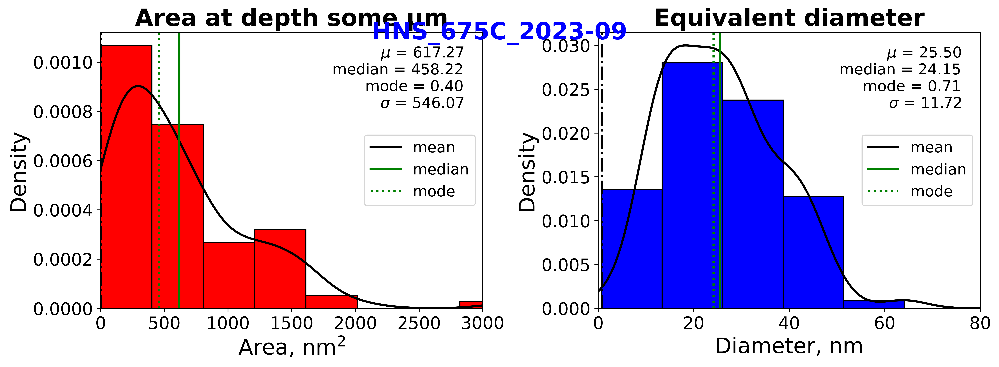

-----------------------

Folder: HNS_700C_2023-13

Area kurt < 0, use Sturges, bins = 9
Area kurt < 0, use Sturges, bins = 9
Area kurt < 0, use Sturges, bins = 8
Area kurt < 0, use Sturges, bins = 8
Diameter kurt < 0, use Sturges, bins = 8
Area kurt < 0, use Sturges, bins = 8


In [82]:

#* Set the x axis limit to True or False
x_axis_limit = True

for k, folder in enumerate(df_dict_folder.keys()):
    print(f'-----------------------\n')
    print(f'Folder: {folder}\n')
    # number pf plot columns
    nrow = df_dict_folder[folder].shape[1]
    nrows = int(nrow/2)
    # histogram
    fig, ax = plt.subplots(nrows=nrows, ncols=2, figsize=(13, 4.6*nrows), dpi=600)
    # make fig title
    fig.suptitle(folder, fontsize=22, fontweight='bold', color='Blue')
    ax = ax.flatten()
    # Make histograms
    for i in range(nrows):
        # name of the column
        col_name = df_dict_folder[folder].columns[2*i]
        depth = ' at depth '+col_name.split(' ')[0]+' µm'
        # decide on number of bins
        data_colum_even = df_dict_folder[folder].iloc[:, 2*i].dropna() 
        n = len(data_colum_even)
        kurt = kurtosis(data_colum_even) * (len(data_colum_even) / 6.) ** 0.5
        if kurt > 0:
            bins = doanes(data_colum_even)
            print(f'Area kurt < 0, use Sturges, bins = {bins}')
        else:
            bins = sturges(n)
            # bins = square_root(n)
        # bins = doanes(df_dict_folder[folder].iloc[:, 2*i].dropna())
        # Make histogram for Area columns
        df_dict_folder[folder].iloc[:, 2*i].hist(ax=ax[2*i],
                                                # bins=50,
                                                bins=bins,
                                                color='red',
                                                edgecolor='black',  # Set the edgecolor to black
                                                grid=False, 
                                                density=True
                                                )
        # add KDE plot
        df_dict_folder[folder].iloc[:, 2*i].plot.kde(ax=ax[2*i],
                                                    color='black',
                                                    linewidth=2,
                                                    )
        ax[2*i].set_title('Area'+depth, fontsize=22, fontweight='bold')
        ax[2*i].set_ylabel('Density', fontsize=20)
        ax[2*i].set_xlabel('Area, $\\mathrm{nm}^2$', fontsize=20)
        ax[2*i].tick_params(axis='both', which='major', labelsize=16)
        if x_axis_limit:
            ax[2*i].set_xlim(0, 3000)
        # ax[2*i].set_xlim(0, 3000)
        # calculate column mean and std
        mean = df_dict_folder[folder].iloc[:, 2*i].mean()
        std = df_dict_folder[folder].iloc[:, 2*i].std()
        # meadian
        median = df_dict_folder[folder].iloc[:, 2*i].median()
        # mode
        mode = df_dict_folder[folder].iloc[:, 2*i].mode().iloc[0]
        # add vertical lines
        ax[2*i].axvline(mean, color='green', linestyle='solid', linewidth=2)
        # ax[2*i].axvline(mean+std, color='black', linestyle='dashed', linewidth=2)
        # ax[2*i].axvline(mean-std, color='black', linestyle='dashed', linewidth=2)
        ax[2*i].axvline(median, color='green', linestyle='dotted', linewidth=2)
        ax[2*i].axvline(mode, color='black', linestyle='dashdot', linewidth=2)
        # add text
        ax[2*i].text(0.95, 0.95, f'$\\mu$ = {mean:.2f}\nmedian = {median:.2f}\nmode = {mode:.2f}\n$\\sigma$ = {std:.2f}',
                    verticalalignment='top', 
                    horizontalalignment='right',
                    transform=ax[2*i].transAxes,
                    color='black', fontsize=14)
        # add legend for lines
        ax[2*i].legend(['mean', 
                        # 'mean+std', 
                        # 'mean-std', 
                        'median', 
                        'mode'
                        ], fontsize=14, loc='center right')


        
        # decide on number of bins
        
        data_colum_even = df_dict_folder[folder].iloc[:, 2*i+1].dropna() 
        n = len(data_colum_even)
        kurt = kurtosis(data_colum_even) * (len(data_colum_even) / 6.) ** 0.5
        if kurt > 0:
            bins = doanes(data_colum_even)
        else:
            bins = sturges(n)
            print(f'Diameter kurt < 0, use Sturges, bins = {bins}')
        
        # n = len(df_dict_folder[folder].iloc[:, 2*i+1].dropna())
        # df_t = df_dict_folder[folder].iloc[:, 2*i+1].dropna()
        # bins = doanes(df_t)


        # Make histogram for Diameter columns
        df_dict_folder[folder].iloc[:, 2*i+1].hist(ax=ax[2*i+1],
                                                # bins=50,
                                                bins=bins,
                                                color='blue',
                                                edgecolor='black',  # Set the edgecolor to black
                                                grid=False,
                                                density=True
                                                )                                             
        # add KDE plot
        df_dict_folder[folder].iloc[:, 2*i+1].plot.kde(ax=ax[2*i+1],
                                                    color='black',
                                                    linewidth=2,
                                                    )
        ax[2*i+1].set_title('Equivalent diameter', fontsize=22, fontweight='bold')
        ax[2*i+1].set_ylabel('Density', fontsize=20)
        ax[2*i+1].set_xlabel('Diameter, nm', fontsize=20)
        ax[2*i+1].tick_params(axis='both', which='major', labelsize=16)
        if x_axis_limit:
            ax[2*i+1].set_xlim(0, 80)
        # calculate column mean and std
        mean = df_dict_folder[folder].iloc[:, 2*i+1].mean()
        std = df_dict_folder[folder].iloc[:, 2*i+1].std()
        # meadian
        median = df_dict_folder[folder].iloc[:, 2*i+1].median()
        # mode
        mode = df_dict_folder[folder].iloc[:, 2*i+1].mode().iloc[0]
        # add vertical lines
        ax[2*i+1].axvline(mean, color='green', linestyle='solid', linewidth=2)
        # ax[2*i+1].axvline(mean+std, color='black', linestyle='dashed', linewidth=2)
        # ax[2*i+1].axvline(mean-std, color='black', linestyle='dashed', linewidth=2)
        ax[2*i+1].axvline(median, color='green', linestyle='dotted', linewidth=2)
        ax[2*i+1].axvline(mode, color='black', linestyle='dashdot', linewidth=2)
        # add text
        ax[2*i+1].text(0.95, 0.95, f'$\\mu$ = {mean:.2f}\nmedian = {median:.2f}\nmode = {mode:.2f}\n$\\sigma$ = {std:.2f}',
                    verticalalignment='top', 
                    horizontalalignment='right',
                    transform=ax[2*i+1].transAxes,
                    color='black', fontsize=14)
        # add legend for lines
        ax[2*i+1].legend(['mean', 
                        # 'mean+std', 
                        # 'mean-std', 
                        'median', 
                        'mode'
                        ], fontsize=14, loc='center right')
        
    fig.tight_layout()
    plt.subplots_adjust(top=0.95)  # Adjust the top spacing for the title
    #save figure
    if x_axis_limit:
        plt.savefig(path_to_save_big_plots + folder + '_histograms_x_axis_limit.png', dpi=300)
    else:
        plt.savefig(path_to_save_big_plots + folder + '_histograms_no_x_limit.png', dpi=300)
    plt.show()

This cell contains the code for generating histograms and KDE plots for the area and equivalent diameter of domains at different temperatures. The histograms include vertical lines representing the mean, median, and mode of the distributions. The x-axis limits can be set to a specific range based on the `x_axis_limit` variable. The plots are saved as PNG files in the specified directory.

In [83]:
# x limits True or False
x_axis_limit = True

k = len(df_dict_folder.keys())
fig, ax = plt.subplots(nrows=k, ncols=2, figsize=(13, 4.5*k), dpi=600)
ax = ax.flatten()
for idx, folder in enumerate(df_dict_folder.keys()):
    print(f'-----------------------\n')
    print(f'Folder: {folder}\n')
    nrow = df_dict_folder[folder].shape[1]
    nrows = int(nrow/2)
    # histogram

    # make fig title
    # fig.suptitle(folder, fontsize=22, fontweight='bold', color='Blue')

    # Make histograms
    for i in range(nrows):
        # name of the column
        col_name = df_dict_folder[folder].columns[2*i]
        depth = col_name.split(' ')[0]+' µm'
        temperature = folder.split('_')[1]

        # # add KDE plot for Areas  
        df_dict_folder[folder].iloc[:, 2*i].plot.kde(ax=ax[2*idx],
                                                    # color='red',
                                                    linewidth=3,
                                                    label=depth
                                                    )
        ax[2*idx].set_title('Area at '+temperature, fontsize=22, fontweight='bold')
        ax[2*idx].set_ylabel('Density', fontsize=20)
        ax[2*idx].set_xlabel('Area, $\\mathrm{nm}^2$', fontsize=20)
        ax[2*idx].tick_params(axis='both', which='major', labelsize=16)
        if x_axis_limit:
            ax[2*idx].set_xlim(0, 3000)
        # ax[2*idx].set_xlim(0, 3000)
        # add legend
        ax[2*idx].legend(
                        fontsize=14, 
                        # loc='top right'
                            )

        # add KDE plot for Diameter
        df_dict_folder[folder].iloc[:, 2*i+1].plot.kde(ax=ax[2*idx+1],
                                                    # color='blue',
                                                    linewidth=3,
                                                    )
        ax[2*idx+1].set_title('Equivalent diameter', fontsize=22, fontweight='bold')
        ax[2*idx+1].set_ylabel('Density', fontsize=20)
        ax[2*idx+1].set_xlabel('Diameter, nm', fontsize=20)
        ax[2*idx+1].tick_params(axis='both', which='major', labelsize=16)
        if x_axis_limit:
            ax[2*idx+1].set_xlim(0, 80)
        ax[2*idx+1].set_xlim(0, 80)
        # add legend
        ax[2*idx+1].legend(
                        fontsize=14, 
                        # loc='top right'
                            )
fig.tight_layout()
    #save figure
if x_axis_limit:
    plt.savefig(path_to_save_big_plots + 'all_kde_plots_x_axis_limit.png', dpi=300)
else:
    plt.savefig(path_to_save_big_plots + 'all_kde_plots_no_x_limit.png', dpi=300)
# plt.savefig(path_to_save_big_plots + folder + '_kde_plots.png', dpi=300)
plt.show()

-----------------------

Folder: HNS_0C_sieved40um_2023-13

-----------------------

Folder: HNS_625C_2023-13

-----------------------

Folder: HNS_650C_2023-13

-----------------------

Folder: HNS_675C_2023-09

-----------------------

Folder: HNS_700C_2023-13



This cell contains the code for generating a combined DataFrame that includes the areas and equivalent diameters of domains from all folders. The code iterates through the folders, selects the columns with area and diameter data, and concatenates them into a single DataFrame. The combined DataFrame is then saved as a CSV file. Additionally, descriptive statistics for the combined DataFrame are calculated and saved as another CSV file. The statistics include measures such as count, mean, standard deviation, minimum, 25th percentile, median, 75th percentile, maximum, skewness, kurtosis, mode, and variance.

In [84]:

df_areas_d_all = pd.DataFrame()
for k, folder in enumerate(df_dict_folder.keys()):
# Выбираем столбцы с площадью (четные индексы)
    df_areas = df_dict_folder[folder].iloc[:, ::2]

    # Выбираем столбцы с диаметром (нечетные индексы)
    df_diameters = df_dict_folder[folder].iloc[:, 1::2]

    # Преобразуем столбцы в один
    df_areas_melted = df_areas.melt(var_name="Column", value_name=folder+"_A")
    df_diameters_melted = df_diameters.melt(var_name="Column", value_name=folder+"_d")

    # Объединяем два DataFrame в один
    df_final = pd.concat([df_areas_melted, df_diameters_melted], axis=1)
    df_areas_d_all = pd.concat([df_areas_d_all, df_final], axis=1)

#save dataframe
df_areas_d_all.to_csv(path_to_save_csv + 'all_areas_diameters.csv', index=False)

# statistics

df_areas_d_all_statistics = df_areas_d_all.describe()
#take only even columns of df_areas_d_all

# add median
df_areas_d_all_statistics.loc['median'] = df_areas_d_all.iloc[:,1::2].median()
# add mode
df_areas_d_all_statistics.loc['mode'] = df_areas_d_all.iloc[:,1::2].mode().iloc[0]
# add variance
df_areas_d_all_statistics.loc['variance'] = df_areas_d_all.iloc[:,1::2].var()
# add skewness
df_areas_d_all_statistics.loc['skewness'] = df_areas_d_all.iloc[:,1::2].skew()
# add kurtosis
df_areas_d_all_statistics.loc['kurtosis'] = df_areas_d_all.iloc[:,1::2].kurtosis()
# save statistics
df_areas_d_all_statistics.to_csv(path_to_save_csv + 'all_areas_diameters_statistics.csv', index=True)
# drop even columns
df_areas_d_all = df_areas_d_all.iloc[:, 1::2]
df_areas_d_all_statistics


,HNS_0C_sieved40um_2023-13_A,HNS_0C_sieved40um_2023-13_d,HNS_625C_2023-13_A,HNS_625C_2023-13_d,HNS_650C_2023-13_A,HNS_650C_2023-13_d,HNS_675C_2023-09_A,HNS_675C_2023-09_d,HNS_700C_2023-13_A,HNS_700C_2023-13_d
count,1051.000000,1051.000000,1679.000000,1679.000000,572.000000,572.000000,93.000000,93.000000,580.000000,580.000000
mean,46.772185,7.477942,82.848358,9.902746,328.325687,18.581027,617.270044,25.495644,743.733117,27.204020
std,24.668762,1.906841,48.135663,2.725042,306.634903,8.538745,546.072070,11.721006,812.682140,14.396147
min,0.077934,0.315005,0.030271,0.196323,0.216614,0.525168,0.398569,0.712372,0.307591,0.625809
25%,30.746938,6.256853,51.431279,8.092239,109.319479,11.797872,193.171694,15.682916,221.995385,16.812273
50%,42.826634,7.384346,71.667776,9.552500,207.110780,16.238867,458.220119,24.154171,449.919486,23.934225
75%,58.133535,8.603366,101.183570,11.350371,475.451733,24.604143,834.291690,32.592226,986.340371,35.437865
max,256.366644,18.066991,495.384449,25.114599,2092.548221,51.617004,3223.700212,64.066704,5992.165241,87.346790
median,42.826634,7.384346,71.667776,9.552500,207.110780,16.238867,458.220119,24.154171,449.919486,23.934225
mode,12.156547,3.934234,30.174199,6.198305,85.545051,10.436443,0.398569,0.712372,0.307591,0.625809


In [85]:
# from docx import Document
# from docx.shared import Inches
# from docx.enum.table import WD_TABLE_ALIGNMENT
# from docx.enum.text import WD_ALIGN_PARAGRAPH
# from docx.shared import Pt

# # create a document
# document = Document()
# # set font size
# style = document.styles['Normal']
# font = style.font
# font.name = 'Times New Roman'
# font.size = Pt(12)
# # change page orientation
# sections = document.sections
# for section in sections:
#     section.orientation = 1 # 0 - portrait, 1 - landscape
#     section.page_width = Inches(11.69)
#     section.page_height = Inches(8.27)
# # add title
# document.add_heading('Domain size statistics', 0)
# # add text
# p = document.add_paragraph('The following tables contain descriptive statistics for domain size in each folder:\n')
# p.add_run('Area').bold = True
# p.add_run(' is the area of the domain in ')
# p.add_run('nm^2\n').bold = True
# p.add_run('Diameter').bold = True
# p.add_run(' is the equivalent diameter of the domain in ')
# p.add_run('nm\n').bold = True
# p.add_run('Count').bold = True
# p.add_run(' is the number of domains in the distribution\n')
# p.add_run('Mean').bold = True
# p.add_run(' is the mean of the distribution\n')
# p.add_run('Std').bold = True
# p.add_run(' is the standard deviation of the distribution\n')
# p.add_run('Min').bold = True
# p.add_run(' is the minimum value of the distribution\n')
# p.add_run('25%').bold = True
# p.add_run(' is the 25th percentile of the distribution\n')
# p.add_run('50%').bold = True
# p.add_run(' is the 50th percentile of the distribution\n')
# p.add_run('75%').bold = True
# p.add_run(' is the 75th percentile of the distribution\n')
# p.add_run('Max').bold = True
# p.add_run(' is the maximum value of the distribution\n')

# p.add_run('Skewness').bold = True
# p.add_run(' is the degree of distortion from the normal distribution\n')
# p.add_run('Kurtosis').bold = True
# p.add_run(' is the degree of peakedness of the distribution\n')
# p.add_run('Median').bold = True
# p.add_run(' is the median of the distribution\n')
# p.add_run('Mode').bold = True
# p.add_run(' is the mode of the distribution\n')
# p.add_run('Variance').bold = True
# p.add_run(' is the variance of the distribution')
# document.add_page_break()

# # loop over folders
# for idx, folder in enumerate(df_areas_d_all_statistics.keys()):
#     # add table caption
#     table_caption = document.add_paragraph()
#     table_caption.alignment = WD_ALIGN_PARAGRAPH.CENTER
#     table_caption.add_run(f'Table {idx+1}. Descriptive statistics for domain size in {folder}').bold = True
    
#     # Check if the dataframe is not empty
#     # if isinstance(df_areas_d_all_statistics[folder], pd.DataFrame) and df_areas_d_all_statistics[folder].shape[0] > 0 and df_areas_d_all_statistics[folder].shape[1] > 0:
#         # create a table
#     table = document.add_table(rows=df_areas_d_all_statistics[folder].shape[0]+1, cols=df_areas_d_all_statistics[folder].shape[1]+1)
#     table.style = 'Table Grid'
#     # fill the first row with column names
#     for j in range(df_areas_d_all_statistics[folder].shape[1]):
#         table.cell(0, j+1).text = df_areas_d_all_statistics[folder].columns[j]
#         #make the first row bold
#         table.cell(0, j+1).paragraphs[0].runs[0].font.bold = True
#     # fill the first column with row names
#     for i in range(df_areas_d_all_statistics[folder].shape[0]):
#         table.cell(i+1, 0).text = df_areas_d_all_statistics[folder].index[i]
#         #make the first column bold
#         table.cell(i+1, 0).paragraphs[0].runs[0].font.bold = True

#     # fill the table with data
#     for i in range(df_areas_d_all_statistics[folder].shape[0]):
#         for j in range(df_areas_d_all_statistics[folder].shape[1]):
#             table.cell(i+1, j+1).text = "{:.2f}".format(df_areas_d_all_statistics[folder].iloc[i, j])
#     # set table alignment
#     table.alignment = WD_TABLE_ALIGNMENT.CENTER
#     # set table font size
#     for row in table.rows:
#         for cell in row.cells:
#             paragraphs = cell.paragraphs
#             for paragraph in paragraphs:
#                 for run in paragraph.runs:
#                     font = run.font
#                     font.size = Pt(12)
    
#     # add new page
#     document.add_page_break()
# # save document
# document.save(path_to_save_csv + 'all_statistics.docx')

# #open document
# os.system(f'open {path_to_save_csv}all_statistics.docx')

This cell contains the code for generating a combined DataFrame that includes the areas and equivalent diameters of domains from all folders. The code iterates through the folders, selects the columns with area and diameter data, and concatenates them into a single DataFrame. The combined DataFrame is then saved as a CSV file. Additionally, descriptive statistics for the combined DataFrame are calculated and saved as another CSV file. The statistics include measures such as count, mean, standard deviation, minimum, 25th percentile, median, 75th percentile, maximum, skewness, kurtosis, mode, and variance.

In [86]:

nrow = df_areas_d_all.shape[1]
nrows = int(nrow/2)
fig, axes = plt.subplots(nrows=nrows, ncols=2, figsize=(13, 4.5*nrows), dpi=600)
axes = axes.flatten()
# Make histograms
for i in range(nrows):
    
    
    # name of the column
    col_name = df_areas_d_all.columns[2*i]
    temp = col_name[:-2]
    # depth = ' at depth '+col_name.split(' ')[0]+' µm'
    #decide on number of bins
    data_colum_even = df_areas_d_all.iloc[:, 2*i].dropna() 
    n = len(data_colum_even)
    kurt = kurtosis(data_colum_even) * (len(data_colum_even) / 6.) ** 0.5
    if kurt > 0:
        bins = doanes(data_colum_even)
        print(f'Area kurt < 0, use Sturges, bins = {bins}')
    else:
        bins = sturges(n)
    # Make histogram for Area columns
    df_areas_d_all.iloc[:, 2*i].hist(ax=axes[2*i],
                                            # bins=50,
                                            bins=bins,
                                            color='red',
                                            edgecolor='black',  # Set the edgecolor to black
                                            grid=False, 
                                            density=True
                                            )
    # add KDE plot
    df_areas_d_all.iloc[:, 2*i].plot.kde(ax=axes[2*i],
                                                color='black',
                                                linewidth=2,
                                                )
    axes[2*i].set_title('Area for '+temp, fontsize=22, fontweight='bold')
    axes[2*i].set_ylabel('Density', fontsize=20)
    axes[2*i].set_xlabel('Area, $\\mathrm{nm}^2$', fontsize=20)
    axes[2*i].tick_params(axis='both', which='major', labelsize=16)
    axes[2*i].set_xlim(0, 3000)
    # calculate column mean and std
    mean = df_areas_d_all.iloc[:, 2*i].mean()
    std = df_areas_d_all.iloc[:, 2*i].std()
    # meadian
    median = df_areas_d_all.iloc[:, 2*i].median()
    # mode
    mode = df_areas_d_all.iloc[:, 2*i].mode().iloc[0]
    # add vertical lines
    axes[2*i].axvline(mean, color='green', linestyle='solid', linewidth=2)
    # axes[2*i].axvline(mean+std, color='black', linestyle='dashed', linewidth=2)
    # axes[2*i].axvline(mean-std, color='black', linestyle='dashed', linewidth=2)
    axes[2*i].axvline(median, color='green', linestyle='dotted', linewidth=2)
    axes[2*i].axvline(mode, color='black', linestyle='dashdot', linewidth=2)
    # add text
    axes[2*i].text(0.95, 0.95, f'$\\mu$ = {mean:.2f}\nmedian = {median:.2f}\nmode = {mode:.2f}\n$\\sigma$ = {std:.2f}',
                verticalalignment='top', 
                horizontalalignment='right',
                transform=axes[2*i].transAxes,
                color='black', fontsize=14)
    # add legend for lines
    axes[2*i].legend(['mean', 
                    # 'mean+std', 
                    # 'mean-std', 
                    'median', 
                    'mode'
                    ], fontsize=14, loc='center right')
    # decide on number of bins
    data_colum_even = df_areas_d_all.iloc[:, 2*i+1].dropna()
    n = len(data_colum_even)
    kurt = kurtosis(data_colum_even) * (len(data_colum_even) / 6.) ** 0.5
    if kurt > 0:
        bins = doanes(data_colum_even)
    else:
        bins = sturges(n)
        print(f'Diameter kurt < 0, use Sturges, bins = {bins}')
    # Make histogram for Diameter columns
    df_areas_d_all.iloc[:, 2*i+1].hist(ax=axes[2*i+1],
                                            # bins=50,
                                            bins=bins,
                                            color='blue',
                                            edgecolor='black',  # Set the edgecolor to black
                                            grid=False,
                                            density=True
                                            )
    # add KDE plot
    df_areas_d_all.iloc[:, 2*i+1].plot.kde(ax=axes[2*i+1],
                                                color='black',
                                                linewidth=2,
                                                )
    axes[2*i+1].set_title('Equivalent diameter', fontsize=22, fontweight='bold')
    axes[2*i+1].set_ylabel('Density', fontsize=20)
    axes[2*i+1].set_xlabel('Diameter, nm', fontsize=20)
    axes[2*i+1].tick_params(axis='both', which='major', labelsize=16)
    axes[2*i+1].set_xlim(0, 80)
    # calculate column mean and std
    mean = df_areas_d_all.iloc[:, 2*i+1].mean()
    std = df_areas_d_all.iloc[:, 2*i+1].std()
    # meadian
    median = df_areas_d_all.iloc[:, 2*i+1].median()
    # mode
    mode = df_areas_d_all.iloc[:, 2*i+1].mode().iloc[0]
    # add vertical lines
    axes[2*i+1].axvline(mean, color='green', linestyle='solid', linewidth=2)
    # axes[2*i+1].axvline(mean+std, color='black', linestyle='dashed', linewidth=2)
    # axes[2*i+1].axvline(mean-std, color='black', linestyle='dashed', linewidth=2)
    axes[2*i+1].axvline(median, color='green', linestyle='dotted', linewidth=2)
    axes[2*i+1].axvline(mode, color='black', linestyle='dashdot', linewidth=2)
    # add text
    axes[2*i+1].text(0.95, 0.95, f'$\\mu$ = {mean:.2f}\nmedian = {median:.2f}\nmode = {mode:.2f}\n$\\sigma$ = {std:.2f}',
                verticalalignment='top', 
                horizontalalignment='right',
                transform=axes[2*i+1].transAxes,
                color='black', fontsize=14)
    # add legend for lines
    axes[2*i+1].legend(['mean', 
                    # 'mean+std', 
                    # 'mean-std', 
                    'median', 
                    'mode'
                    ], fontsize=14, loc='center right')
fig.tight_layout()
#save figure
plt.savefig(path_to_save_big_plots + 'all_areas_diameters_histograms.png', dpi=300)
plt.show()

Area kurt < 0, use Sturges, bins = 12
Area kurt < 0, use Sturges, bins = 13
Area kurt < 0, use Sturges, bins = 11
Area kurt < 0, use Sturges, bins = 8
Area kurt < 0, use Sturges, bins = 11


This cell contains the code for generating a combined DataFrame that includes the areas and equivalent diameters of domains from all folders. The code iterates through the folders, selects the columns with area and diameter data, and concatenates them into a single DataFrame. The combined DataFrame is then saved as a CSV file. Additionally, descriptive statistics for the combined DataFrame are calculated and saved as another CSV file. The statistics include measures such as count, mean, standard deviation, minimum, 25th percentile, median, 75th percentile, maximum, skewness, kurtosis, mode, and variance.

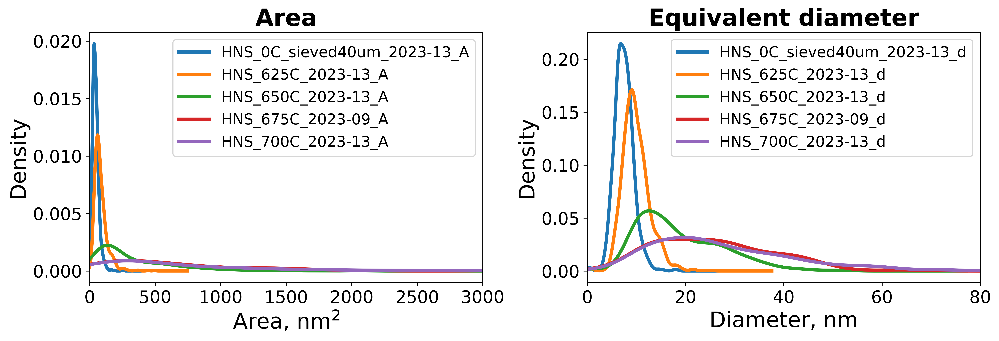

In [87]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(13, 4.5), dpi=600)

# for idx, folder in enumerate(df_areas_d_all.columns):
    # add KDE plot for Areas  
df_areas_d_all.iloc[:, ::2].plot.kde(ax=axes[0],
                                            # color='red',
                                            linewidth=3,
                                            label=folder
                                            )
axes[0].set_title('Area', fontsize=22, fontweight='bold')
axes[0].set_ylabel('Density', fontsize=20)
axes[0].set_xlabel('Area, $\\mathrm{nm}^2$', fontsize=20)
axes[0].tick_params(axis='both', which='major', labelsize=16)
axes[0].set_xlim(0, 3000)
# add legend
axes[0].legend(
                fontsize=14, 
                # loc='top right'
                    )

# add KDE plot for Diameter
df_areas_d_all.iloc[:, 1::2].plot.kde(ax=axes[1],
                                            # color='blue',
                                            linewidth=3,
                                            )
axes[1].set_title('Equivalent diameter', fontsize=22, fontweight='bold')
axes[1].set_ylabel('Density', fontsize=20)
axes[1].set_xlabel('Diameter, nm', fontsize=20)
axes[1].tick_params(axis='both', which='major', labelsize=16)
axes[1].set_xlim(0, 80)
# add legend
axes[1].legend(
                fontsize=14, 
                # loc='top right'
                    )
fig.tight_layout()
#save figure
plt.savefig(path_to_save_big_plots + 'all_areas_diameters_kde_plots.png', dpi=300)
plt.show()

This cell contains the code for generating box plots for the area and equivalent diameter of domains from all folders. The box plots include mean and median lines, and the x-axis labels are adjusted to show the temperature values. The plots are saved as PNG files in the specified directory.

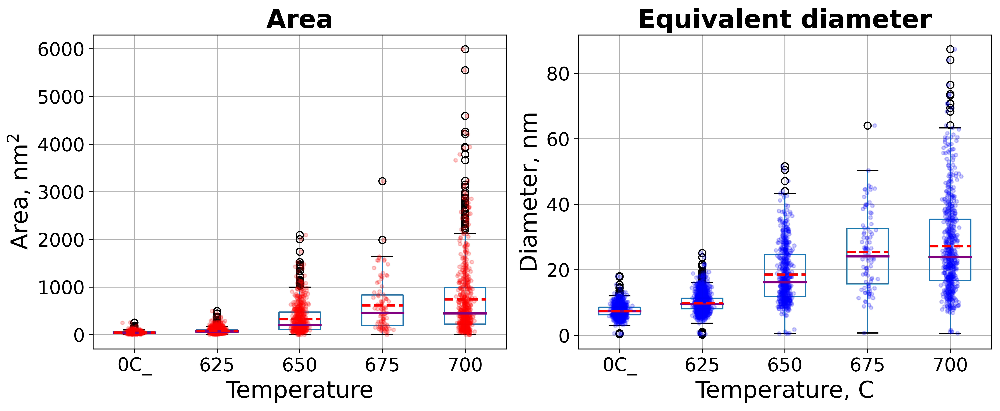

In [88]:
# boxplot
fig, ax = plt.subplots(1, 2, figsize=(12, 5), dpi=600)
# Make box plot for Area columns
df_areas_d_all.iloc[:, ::2].boxplot(ax=ax[0],
                                    showmeans=True,
                                    meanline=True,
                                    meanprops={'color': 'red', 'linewidth': 2},
                                    medianprops={'color': 'purple','linewidth': 2},
                                    )
ax[0].set_title('Area', fontsize=22, fontweight='bold')
ax[0].set_ylabel('Area, $\\mathrm{nm}^2$', fontsize=20)
ax[0].set_xlabel('Temperature', fontsize=20)
ax[0].tick_params(axis='both', which='major', labelsize=16)
# change xticklabels
xticklabels = [item.get_text() for item in ax[0].get_xticklabels()]
# xticklabels = [xticklabel[:-2] for xticklabel in xticklabels]
xticklabels = [xticklabel[4:7] for xticklabel in xticklabels]
ax[0].set_xticklabels(xticklabels)
# add overlay with actual data
for i in range(len(list(df_areas_d_all.iloc[:, ::2].columns))):
    y = df_areas_d_all.iloc[:, ::2].iloc[:, i]
    x = np.random.normal(i+1, 0.04, size=len(y))
    ax[0].plot(x, y, 'r.', alpha=0.2)


# Make box plot for Diameter columns
df_areas_d_all.iloc[:, 1::2].boxplot(ax=ax[1],
                                    showmeans=True,
                                    meanline=True,
                                    meanprops={'color': 'red', 'linewidth': 2},
                                    medianprops={'color': 'purple','linewidth': 2},
                                    )
ax[1].set_title('Equivalent diameter', fontsize=22, fontweight='bold')
ax[1].set_ylabel('Diameter, nm', fontsize=20)
ax[1].set_xlabel('Temperature, C', fontsize=20)
ax[1].tick_params(axis='both', which='major', labelsize=16)
# change xticklabels
xticklabels = [item.get_text() for item in ax[1].get_xticklabels()]
xticklabels = [xticklabel[4:7] for xticklabel in xticklabels]
ax[1].set_xticklabels(xticklabels)
# add overlayt with actual data
for i in range(len(list(df_areas_d_all.iloc[:, 1::2].columns))):
    y = df_areas_d_all.iloc[:, 1::2].iloc[:, i]
    x = np.random.normal(i+1, 0.04, size=len(y))
    ax[1].plot(x, y, 'b.', alpha=0.2)
fig.tight_layout()
#save figure
plt.savefig(path_to_save_big_plots + 'all_areas_diameters_boxplots.png', dpi=300)
plt.show()

This cell contains the code for generating bar plots for the mean area and equivalent diameter of domains from all folders. The bar plots include error bars representing the standard deviation. The x-axis labels are adjusted to show the temperature values. The plots are saved as PNG files in the specified directory.

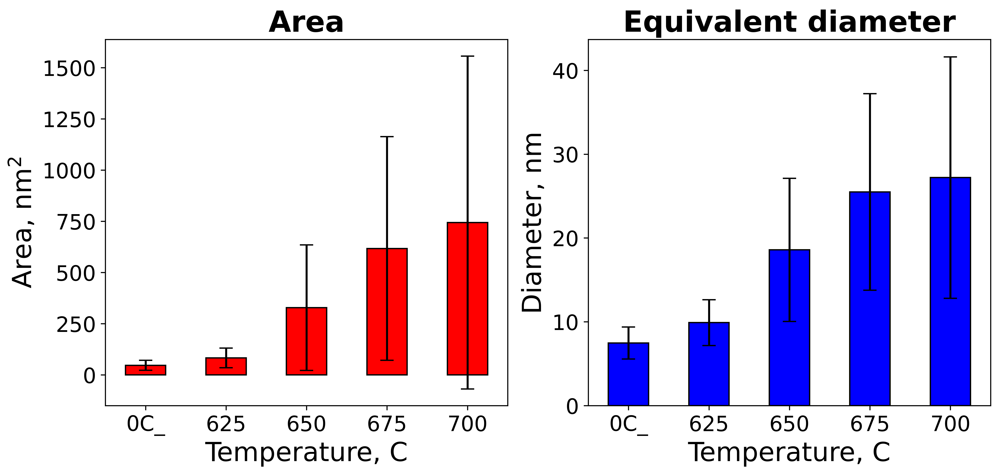

In [89]:
# bar plot
fig, ax = plt.subplots(1, 2, figsize=(12, 5), dpi=600)
# Make bar plot for Area columns
df_areas_d_all.iloc[:, ::2].mean().plot.bar(ax=ax[0],
                                            yerr=df_areas_d_all.iloc[:, ::2].std(),
                                            capsize=5,
                                            color='red',
                                            edgecolor='black'  # Set the edgecolor to black
                                            )
ax[0].set_title('Area', fontsize=22, fontweight='bold')
ax[0].set_ylabel('Area, $\\mathrm{nm}^2$', fontsize=20)
ax[0].set_xlabel('Temperature, C', fontsize=20)
ax[0].tick_params(axis='both', which='major', labelsize=16)
# change xticklabels
xticklabels = [item.get_text() for item in ax[0].get_xticklabels()]
xticklabels = [xticklabel[4:7] for xticklabel in xticklabels]
ax[0].set_xticklabels(xticklabels)
# make tick label horizontal
for tick in ax[0].get_xticklabels():
    tick.set_rotation(0)
    

# Make bar plot for Diameter columns
df_areas_d_all.iloc[:, 1::2].mean().plot.bar(ax=ax[1],
                                            yerr=df_areas_d_all.iloc[:, 1::2].std(),
                                            capsize=5,
                                            color='blue',
                                            edgecolor='black'  # Set the edgecolor to black
                                            )
ax[1].set_title('Equivalent diameter', fontsize=22, fontweight='bold')
ax[1].set_ylabel('Diameter, nm', fontsize=20)
ax[1].set_xlabel('Temperature, C', fontsize=20)
ax[1].tick_params(axis='both', which='major', labelsize=16)
# change xticklabels
xticklabels = [item.get_text() for item in ax[1].get_xticklabels()]
xticklabels = [xticklabel[4:7] for xticklabel in xticklabels]
ax[1].set_xticklabels(xticklabels)
for tick in ax[1].get_xticklabels():
    tick.set_rotation(0)
fig.tight_layout
#save figure
plt.savefig(path_to_save_big_plots + 'all_areas_diameters_barplots.png', dpi=300)
plt.show()